In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import animation
import numpy as  np
from scipy import signal
import scipy
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from ipywidgets import interactive
from IPython.display import HTML
import datetime
import math
from sklearn import model_selection
import sklearn.ensemble
import warnings

In [2]:
data_path = "..\\Datasets\\Forecasting_aqua\\ctd_meteo_aua_2019to2021_V2.csv"
format = "%d-%m-%Y"
df = pd.read_csv(data_path)
time_df = pd.to_datetime(df["Datetime"], format=format)
try:
    df.drop("sample",axis=1,inplace=True)
except:
    pass
df['Datetime']= time_df
keys_imp = ['ciliate','mean_chla','cv_chla_day','cv_chla_depth',
            'nauplius','Ammonium','Nitrat','mean_schmidt','windspeed_max',
            'mean_thermocline_depth','mean_epi_temp','mean_oxycline_depth',
            'mean_mixed_layer_depth','mean_global_radiation'
           ]
df['year'] = df['Datetime'].dt.year
df['month'] = df['Datetime'].dt.month
df['day'] = df['Datetime'].dt.day

#drop the first datapoints the first months are only meteorological data
first_point = (~df['mean_chla'].isnull()).idxmax()
dfs = df.drop(index=range(first_point))
df = dfs.reset_index(drop=True)
#drop the first datapoints the first months are only meteorological data
first_point = (~df['mean_chla'].isnull()).idxmax()
dfs = df.drop(index=range(first_point))
df = dfs.reset_index(drop=True)

In [3]:
#prepare the tickslabels
months=[]
fday = []
for day in range(1,366):
    dstr = str(day)
    date = datetime.datetime.strptime("2019-" + dstr, "%Y-%j")
    months.append(date.strftime("%b"))
months,fday = np.unique(months,return_index=True)
#the months are not in order, but the ticks are still correct
print(months)
print(fday)

['Apr' 'Aug' 'Dec' 'Feb' 'Jan' 'Jul' 'Jun' 'Mar' 'May' 'Nov' 'Oct' 'Sep']
[ 90 212 334  31   0 181 151  59 120 304 273 243]


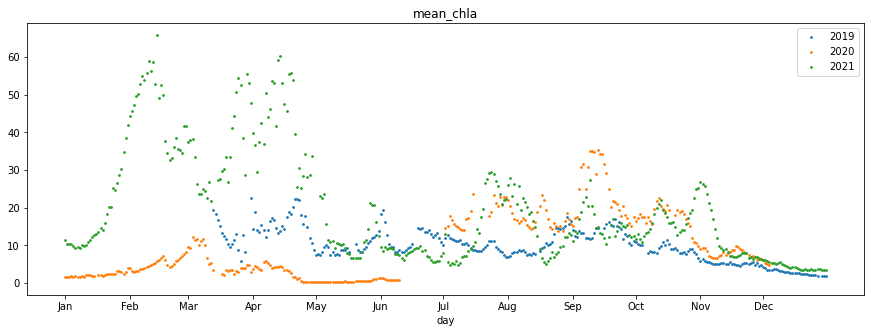

In [4]:
key = 'mean_chla'
fig,ax = plt.subplots(1,figsize=(15,5))

years = df['year'].unique()
for year in years:
    dfy = df[df['year']==year]
    yeardt = np.datetime64(str(year),'Y')
    n_days = (dfy['Datetime']-yeardt).dt.days
    ax.scatter(n_days,dfy[key],s=3)
ax.legend([str(year) for year in years])
ax.set_title(key)
ax.set_xlabel("day")
ax.set_xticks(fday)
ax.set_xticklabels(months)
plt.show()

[]

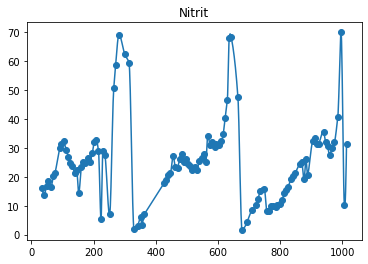

In [5]:
#interpolation
key='Nitrit'
#dfd = df.drop('Datetime',axis=1)
keys_float = df.keys().drop('Datetime')
dfci = df.copy()
dfi = df[keys_float].interpolate(method='akima', limit_direction='forward', axis=0)
dfci[keys_float] = dfi-dfi.mean()
dfci = dfci.fillna(0)
plt.scatter(np.arange(len(df)),df[key])
plt.plot(np.arange(len(dfi)),dfi[key])
plt.title(key)
plt.plot()

## One day predictor for all key variables:

In [10]:
#build train and val datasets
df_t, df_v = sklearn.model_selection.train_test_split(dfci, test_size=0.2, shuffle=False)
df_v.reset_index(inplace=True)
df_tnorm = pd.DataFrame()
df_vnorm = pd.DataFrame()
#datetime format changed into relative day since start
df_tnorm['Datetime'] = df_t['Datetime']-df_t['Datetime'][0]
df_vnorm['Datetime'] = df_v['Datetime']-df_t['Datetime'][0]
#the other keys are standardized
keys_float = df.keys().drop('Datetime') 
df_tnorm[keys_float] = (df_t[keys_float]-df_t[keys_float].mean())/df_t[keys_float].std()
df_vnorm[keys_float] = (df_v[keys_float]-df_t[keys_float].mean())/df_t[keys_float].std()


C:\Users\valla\Anaconda3\lib\site-packages\pandas\core\frame.py:3641: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self[k1] = value[k2]


In [11]:
lag = 30
outkey = ['mean_chla','Ammonium']
def Xy_from_df(df, outkey,lag,inkey=df.keys()):
    #create the outputs (only use the valid ones):
    y = df[['Datetime']+outkey][~df[['Datetime']+outkey].isnull().sum(axis=1).astype(bool)]
    #drop all outputs that cannot have inputs
    y = y.drop(y[y['Datetime']-np.timedelta64(lag,'D')<df['Datetime'][0]].index,axis=0)

    #interpolate the data for the inputs (just repeating the last value):
    dfi = df.interpolate(method='ffill')
    #fill the first data with 0s
    keys_float = df.keys().drop('Datetime')
    dfi[keys_float] = dfi[keys_float].fillna(0)
    #create the inputs from the outputs
    X = pd.DataFrame()

    for idx,date in enumerate(y['Datetime']-np.timedelta64(lag,'D')):
        X = X.append(dfi[dfi['Datetime']==date][inkey])

    #now that Xs and ys are created, we can drop the dates.
    X = X.drop(columns=['Datetime'],errors='ignore')
    y = y.drop(columns=['Datetime'],errors='ignore')
    X.reset_index(inplace=True,drop=True)
    y.reset_index(inplace=True,drop=True)
    return X,y
Xt,yt = Xy_from_df(df_tnorm,outkey,lag)
Xv,yv = Xy_from_df(df_vnorm,outkey,lag)

def R2(trues,preds):
    errs2 = np.sum(np.sum(np.square(trues-preds)))
    tot2 = np.sum(np.sum(np.square(trues-np.mean(trues))))
    return 1-errs2/(tot2+0.00001)

$R^2=1-\frac{\sum_{i}(y_i-f_i)^2}{\sum_{i}(y_i -\bar{y})^2}\\$
Where $y_i$ is the truth, $f_i$ the corresponding prediction, and $\bar{y}$ the mean of $y$

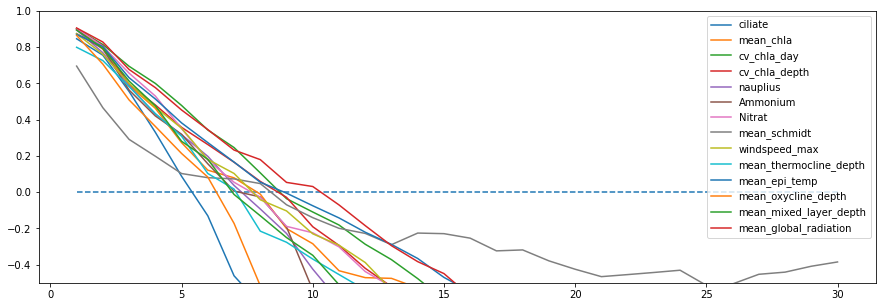

In [12]:
def RF_bootstrap(df_t, df_v,max_lag,keys):
    warnings.filterwarnings("ignore")
    inkey = keys
    outkey = keys
    Xt = df_t[:-1][inkey]
    yt = df_t[1:][outkey]
    Xv = df_v[:-1][inkey]
    yv = df_v[1:][outkey]
    Xt.reset_index(inplace=True,drop=True)
    yt.reset_index(inplace=True,drop=True)
    Xv.reset_index(inplace=True,drop=True)
    yv.reset_index(inplace=True,drop=True)
    model = sklearn.ensemble.RandomForestRegressor(n_estimators=200)
    model.fit(Xt,yt)
    idx = yv.keys().get_loc('mean_chla')
    pred = model.predict(Xv)
    Rv=[R2(yv['mean_chla'],pred[:,idx])]
    for lag in range(1,max_lag):
        #always drop the last item as it wont have a target
        pred = model.predict(pred)[:-1]
        Rv.append(R2(yv[lag:]['mean_chla'],pred[:,idx]))
    return Rv





max_lag = 30

fig,ax = plt.subplots(1,figsize=(15,5))
for key in keys_imp:
    ax.plot(range(1,max_lag+1),RF_bootstrap(df_t,df_v,max_lag,['mean_chla',key]))
    

ax.set_ylim(-0.5, 1)
ax.legend(keys_imp,loc='upper right')
ax.hlines(0,1,max_lag, linestyle='dashed')


Each of the important variables allow a prediction up to one week 

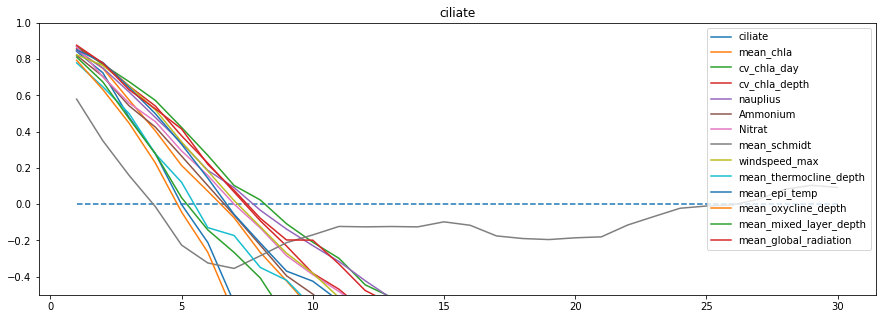

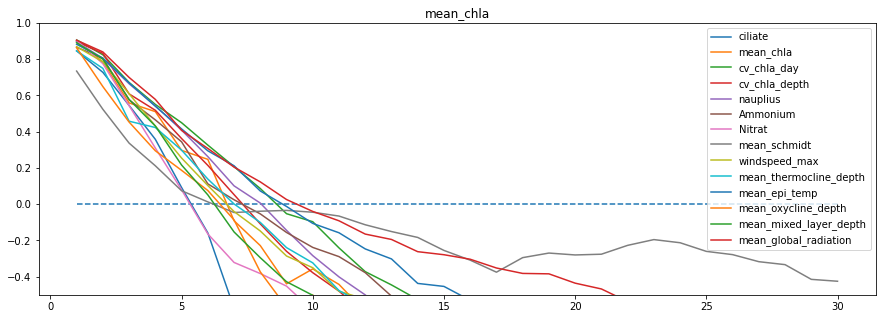

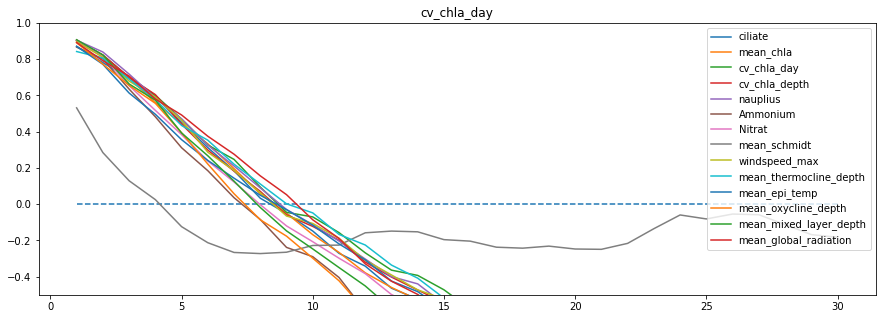

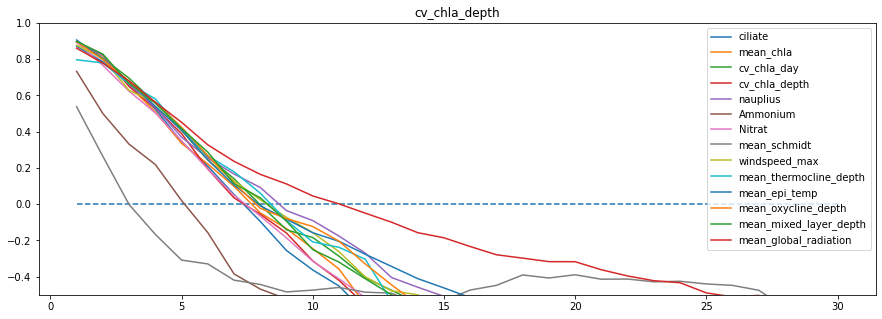

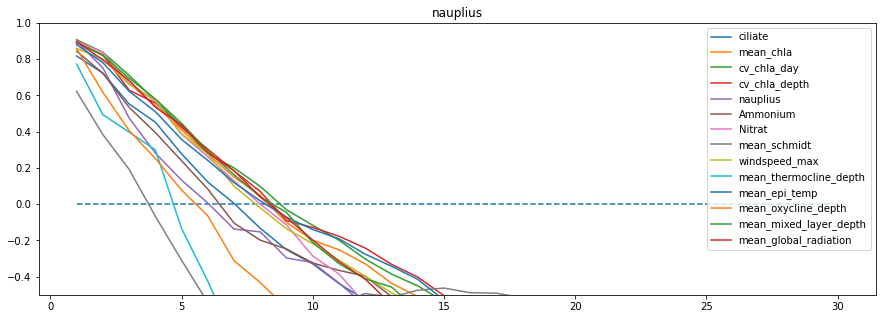

...

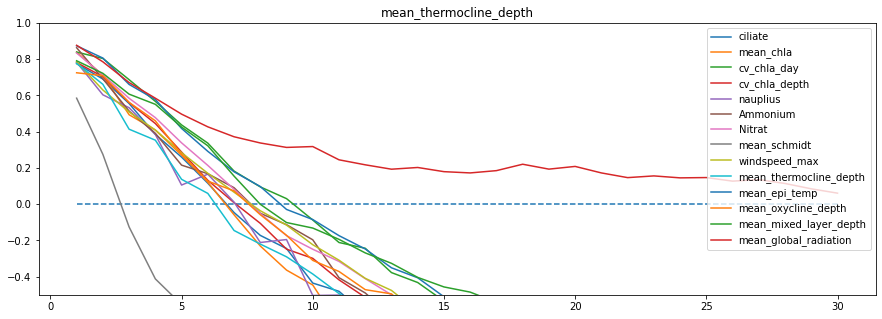

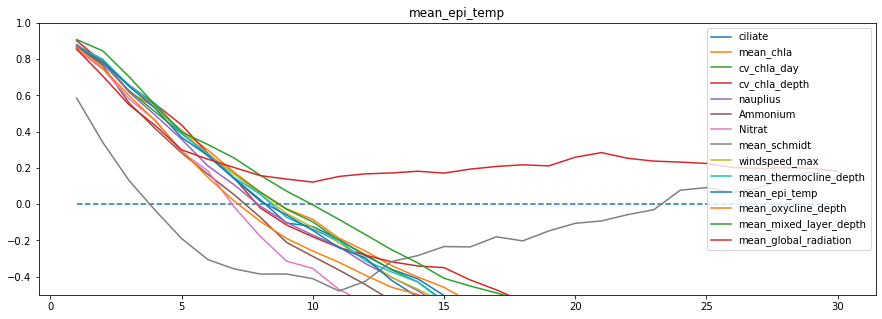

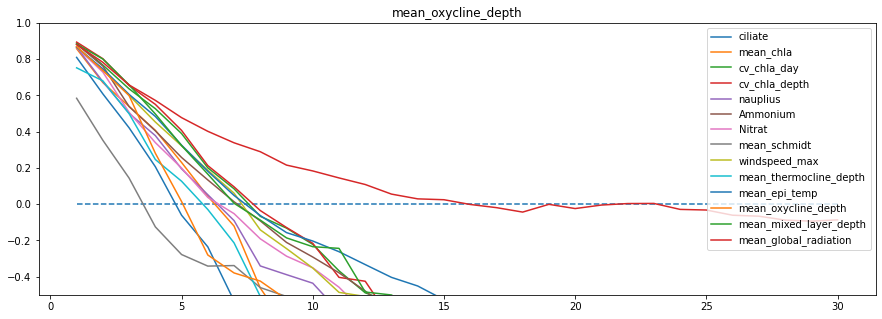

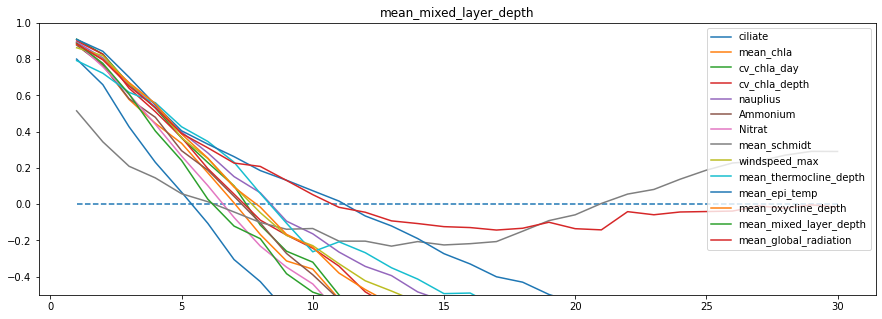

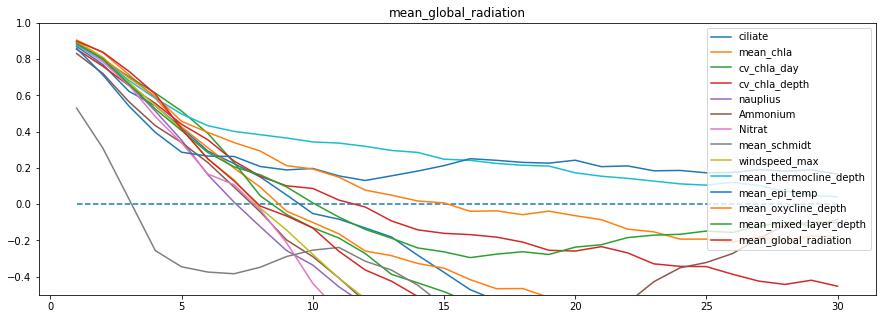

In [23]:
max_lag = 30

for key1 in keys_imp:
    fig,ax = plt.subplots(1,figsize=(15,5))
    ax.set_title(key1)
    for key2 in keys_imp:
        ax.plot(range(1,max_lag+1),RF_bootstrap(df_t,df_v,max_lag,['mean_chla',key1,key2]))


    ax.set_ylim(-0.5, 1)
    ax.legend(keys_imp)
    ax.hlines(0,1,max_lag, linestyle='dashed')
    plt.show()

No clear improvement, perhaps because the explanatory variables are to hard to estimate correctly.

In [24]:
def RF_bootstrap_time(df_t, df_v,max_lag,keys):
    warnings.filterwarnings("ignore")
    date_keys = ['month','day']
    inkey = keys+date_keys
    outkey = keys
    Xt = df_t[:-1][inkey]
    yt = df_t[1:][outkey]
    Xv = df_v[:-1][inkey]
    yv = df_v[1:][outkey]
    date = df_v[1:][date_keys]
    Xt.reset_index(inplace=True,drop=True)
    yt.reset_index(inplace=True,drop=True)
    Xv.reset_index(inplace=True,drop=True)
    yv.reset_index(inplace=True,drop=True)
    
    model = sklearn.ensemble.RandomForestRegressor(n_estimators=200)
    model.fit(Xt,yt)
    idx = yv.keys().get_loc('mean_chla')
    pred = model.predict(Xv)
    pred_t = np.concatenate((pred,date),axis=-1)
    Rv=[R2(yv['mean_chla'],pred[:,idx])]
    for lag in range(1,max_lag):
        #always drop the last item as it wont have a target
        pred = model.predict(pred_t)[:-1]
        date = date[:-1]
        pred_t = np.concatenate((pred,date),axis=-1)
        Rv.append(R2(yv[lag:]['mean_chla'],pred[:,idx]))
    return Rv

In [25]:
max_lag = 30
res_not_timed = np.zeros((len(keys_imp),max_lag))
res_timed = np.zeros((len(keys_imp),max_lag))
for idx,key in enumerate(keys_imp):
    res_not_timed[idx,:] = RF_bootstrap(df_t,df_v,max_lag,['mean_chla',key])
    res_timed[idx,:] = RF_bootstrap_time(df_t,df_v,max_lag,['mean_chla',key])



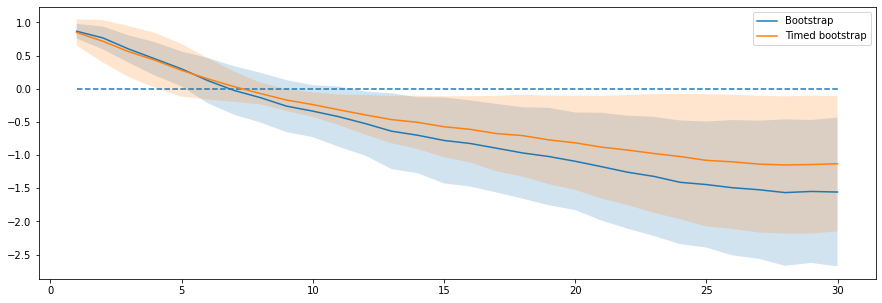

In [26]:
fig,ax = plt.subplots(1,figsize=(15,5))
ax.plot(range(1,max_lag+1),np.mean(res_not_timed,axis=0))
ax.plot(range(1,max_lag+1),np.mean(res_timed,axis=0))
ax.fill_between(range(1,max_lag+1), np.mean(res_not_timed,axis=0) - 1.96*np.std(res_not_timed,axis=0),
                                    np.mean(res_not_timed,axis=0) + 1.96*np.std(res_not_timed,axis=0),
                      alpha=0.2)
ax.fill_between(range(1,max_lag+1), np.mean(res_timed,axis=0) - 1.96*np.std(res_timed,axis=0),
                                    np.mean(res_timed,axis=0) + 1.96*np.std(res_timed,axis=0),
                      alpha=0.2)
#ax.set_ylim(-0.5, 1)
ax.legend(['Bootstrap','Timed bootstrap'])
ax.hlines(0,1,max_lag, linestyle='dashed')
plt.show()

Using a combinaison of both predicted and known variable seems to help

In [30]:
max_lag = 30
res_not_timed = np.zeros((len(df_t.keys()),max_lag))
res_timed = np.zeros((len(df_t.keys()),max_lag))
for idx,key in enumerate(df_t.keys().drop('Datetime')):
    res_not_timed[idx,:] = RF_bootstrap(df_t,df_v,max_lag,['mean_chla',key])
    res_timed[idx,:] = RF_bootstrap_time(df_t,df_v,max_lag,['mean_chla',key])
    print(idx,end='\r')

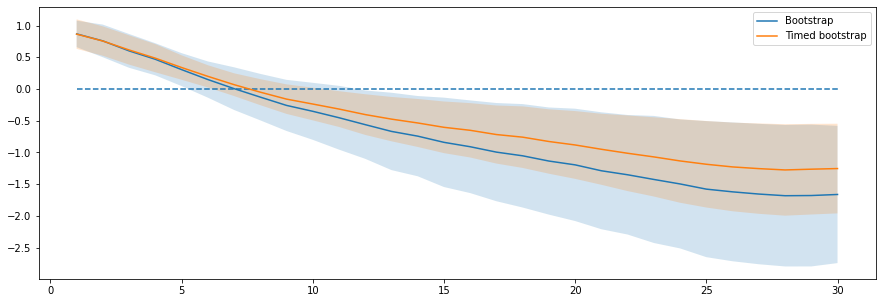

In [31]:
fig,ax = plt.subplots(1,figsize=(15,5))
ax.plot(range(1,max_lag+1),np.mean(res_not_timed,axis=0))
ax.plot(range(1,max_lag+1),np.mean(res_timed,axis=0))
ax.fill_between(range(1,max_lag+1), np.mean(res_not_timed,axis=0) - 1.96*np.std(res_not_timed,axis=0),
                                    np.mean(res_not_timed,axis=0) + 1.96*np.std(res_not_timed,axis=0),
                      alpha=0.2)
ax.fill_between(range(1,max_lag+1), np.mean(res_timed,axis=0) - 1.96*np.std(res_timed,axis=0),
                                    np.mean(res_timed,axis=0) + 1.96*np.std(res_timed,axis=0),
                      alpha=0.2)
#ax.set_ylim(-0.5, 1)
ax.legend(['Bootstrap','Timed bootstrap'])
ax.hlines(0,1,max_lag, linestyle='dashed')
plt.show()

As one can see, the more different keys are tested, the more using known variables is useful

In [337]:
max_lag = 30
res_not_timed_2exp = np.zeros((len(keys_imp)*len(df_t.keys()),max_lag))
res_timed_2exp = np.zeros((len(keys_imp)*len(df_t.keys()),max_lag))
for i,key1 in enumerate(df_t.keys()):
    for j,key2 in enumerate(keys_imp):
        idx=j+len(keys_imp)*i
        res_not_timed_2exp[idx,:] = RF_bootstrap(df_t,df_v,max_lag,['mean_chla',key1,key2])
        res_timed_2exp[idx,:] = RF_bootstrap_time(df_t,df_v,max_lag,['mean_chla',key1,key2])
        print(f"{idx}/{len(keys_imp)*len(df_t.keys())}",end='\r')

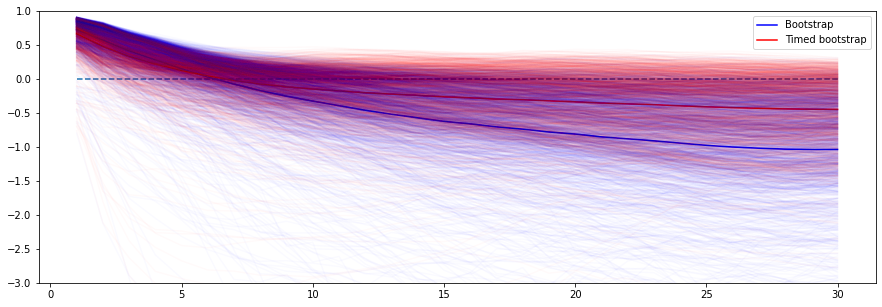

In [345]:
fig,ax = plt.subplots(1,figsize=(15,5))
ax.plot(range(1,max_lag+1),np.mean(res_not_timed_2exp,axis=0),color='b')
ax.plot(range(1,max_lag+1),np.mean(res_timed_2exp,axis=0),color='r')
#ax.fill_between(range(1,max_lag+1), np.mean(res_not_timed_2exp,axis=0) - 1.96*np.std(res_not_timed_2exp,axis=0),
#                                    np.mean(res_not_timed_2exp,axis=0) + 1.96*np.std(res_not_timed_2exp,axis=0),
 #                     alpha=0.2)
#ax.fill_between(range(1,max_lag+1), np.mean(res_timed_2exp,axis=0) - 1.96*np.std(res_timed_2exp,axis=0),
 #                                   np.mean(res_timed_2exp,axis=0) + 1.96*np.std(res_timed_2exp,axis=0),
 #                    alpha=0.2)
for i in range(res_timed_2exp.shape[0]):
    ax.plot(range(1,max_lag+1),res_not_timed_2exp[i,:],color = 'b',alpha=0.02)
    ax.plot(range(1,max_lag+1),res_timed_2exp[i,:],color = 'r',alpha=0.02)
ax.set_ylim(-3, 1)
ax.legend(['Bootstrap','Timed bootstrap'])
ax.hlines(0,1,max_lag, linestyle='dashed')
plt.show()

### Estimating the errors
The "true" error of the model is computed by doing a k-fold validation, and comparing the result to the error of the validation

In [13]:
def kf_test_rf(df,inkey,outkey,n_splits = 10,max_lag=30,min_lag=1):
    X = np.array(df[:-min_lag][inkey])
    y = np.array(df[min_lag:][outkey])
    
    kf = model_selection.KFold(n_splits=n_splits,shuffle=False)
    res = np.zeros((n_splits,max_lag))
    
    for idx,(train_index, test_index) in enumerate(kf.split(X)):
        Xt = X[train_index]
        Xv = X[test_index]
        yt = y[train_index]
        yv = y[test_index]
        model = sklearn.ensemble.RandomForestRegressor(n_estimators=200)
        model.fit(Xt,yt)
        
        chl_loc = df[outkey].keys().get_loc('mean_chla')
        pred = model.predict(Xv)
        res[idx,0]=R2(yv[:,chl_loc],pred[:,chl_loc])
        for lag in range(1,max_lag):
            #always drop the last item as it wont have a target
            pred = model.predict(pred)[:-1]
            res[idx,lag]=R2(yv[lag:,chl_loc],pred[:,chl_loc])
    return res

In [ ]:
inkey = outkey = keys_imp
max_lag = 30
res = kf_test_rf(df_t,inkey,outkey,n_splits = 20,max_lag=max_lag)



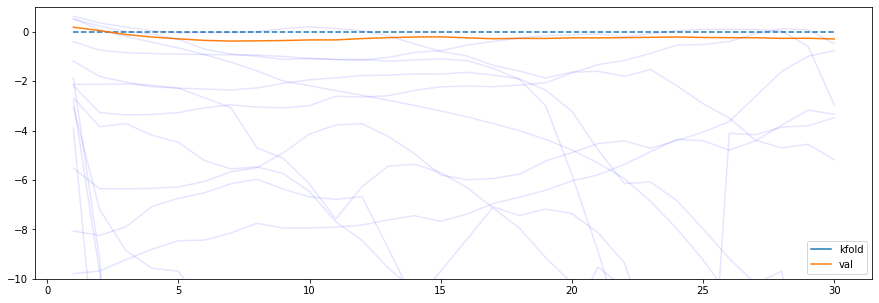

In [34]:
fig,ax = plt.subplots(1,figsize=(15,5))
ax.plot(range(1,max_lag+1),np.mean(res,axis=0))
ax.plot(range(1,max_lag+1),RF_bootstrap(df_t,df_v,max_lag,['mean_chla']+inkey))

for i in range(res.shape[0]):
    ax.plot(range(1,max_lag+1),res[i,:],color = 'b',alpha=0.1)

ax.set_ylim(-10, 1)
ax.legend(['kfold','val'])
ax.hlines(0,1,max_lag, linestyle='dashed')
plt.show()

In [15]:
min_lag = 1
inkey = outkey = ['mean_chla','nauplius','mean_oxycline_depth']
X = np.array(df_tnorm[:-min_lag][inkey])
y = np.array(df_tnorm[min_lag:][outkey])

In [16]:
kf = model_selection.KFold(n_splits=n_splits,shuffle=False)
res = np.zeros((n_splits,max_lag))

for idx,(train_index, test_index) in enumerate(kf.split(X)):
    Xt = X[train_index]
    Xv = X[test_index]
    yt = y[train_index]
    yv = y[test_index]
    model = sklearn.ensemble.RandomForestRegressor(n_estimators=200)
    model.fit(Xt,yt)

    chl_loc = df[outkey].keys().get_loc('mean_chla')
    pred = model.predict(Xv)
    res[idx,0]=R2(yv[:,chl_loc],pred[:,chl_loc])
    for lag in range(1,max_lag):
        #always drop the last item as it wont have a target
        pred = model.predict(pred)[:-1]
        res[idx,lag]=R2(yv[lag:,chl_loc],pred[:,chl_loc])

NameError: name 'n_splits' is not defined

In [17]:
Xt = X[:int(len(X)*0.8)]
Xv = X[int(len(X)*0.8):]
yt = y[:int(len(X)*0.8)]
yv = y[int(len(X)*0.8):]
model = sklearn.ensemble.RandomForestRegressor(n_estimators=200)
model.fit(Xt,yt)


RandomForestRegressor(n_estimators=200)

In [19]:
def plot_ts(X_t,X_v,y_t,y_v,model,lag,keys,timed = False):
    fig,axs = plt.subplots(y_t.shape[1],1,figsize=(10,4*y_t.shape[1]),tight_layout=True)
    artists = {}
    for ax, yt,yv in zip(axs,y_t.T,y_v.T):
        ax.plot(range(len(yt)),yt)
        ax.plot(range(len(yt),len(yt)+len(yv)),yv)
        
    predt = model.predict(X_t)
    predv = model.predict(X_v)

    for l in range(lag-1):
        predt = model.predict(predt)
        predv = model.predict(predv)
    artists['pt']=[]
    artists['pv']=[]
    for ax, pt,pv in zip(axs,predt.T,predv.T):
        artists['pt']+=ax.plot(range(lag-1,lag+len(pt)-1),pt)
        artists['pv']+=ax.plot(range(lag+len(pt)-1,lag+len(pt)-1+len(pv)),pv)
    artists['title']=[]
    for ax,key in zip(axs,keys):
        ax.set_ylabel(key)
        ax.set_xlabel("day")
        ax.legend(["true train",'true val','pred train','pred val'])
        artists['title'] += [ax.set_title(f"Prediction at a lag of "+
                   f" {lag} day")]
    return artists,fig

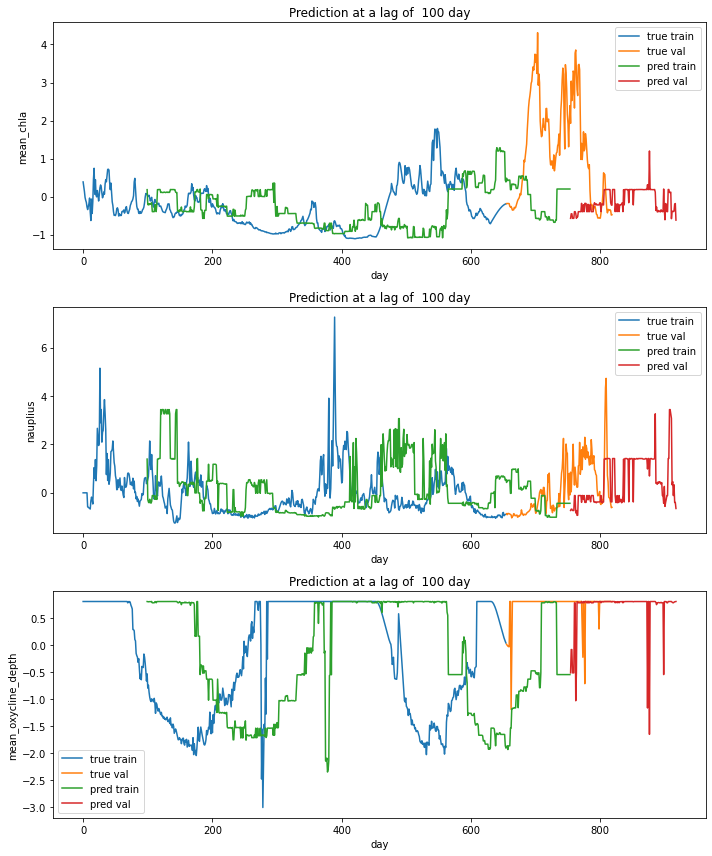

In [20]:
art,fig = plot_ts(Xt,Xv,yt,yv,model,100,inkey)

In [25]:
keys = ['month','day']

X = np.array(df_tnorm[:-1][keys])
y = np.array(df_tnorm[1:][keys])
train_prop=0.9
Xt = X[:int(len(X)*train_prop)]
Xv = X[int(len(X)*train_prop):]
yt = y[:int(len(X)*train_prop)]
yv = y[int(len(X)*train_prop):]
model = sklearn.tree.DecisionTreeRegressor()
#model = sklearn.ensemble.RandomForestRegressor()
model.fit(Xt,yt)

art,fig = plot_ts(Xt,Xv,yt,yv,model,1,keys)

def animate(lag):
    
    predt = model.predict(Xt)
    predv = model.predict(Xv)
    for l in range(lag-1):
        predt = model.predict(predt)
        predv = model.predict(predv)
    for idx, (pt,pv) in enumerate(zip(predt.T,predv.T)):
        art['pt'][idx].set_xdata(range(lag-1,lag+len(pt)-1))
        art['pt'][idx].set_ydata(pt)
        art['pv'][idx].set_xdata(range(lag+len(pt)-1,lag+len(pt)+len(pv)-1))
        art['pv'][idx].set_ydata(pv)
        art['title'][idx].set_text(f"Prediction at a lag of {lag} day")
    return [p for p in art]
ani = animation.FuncAnimation(
    fig, animate,frames = range(1,100), interval=200, blit=False, save_count=50)

plt.close(fig)

HTML(ani.to_jshtml())

In [23]:
R2(yv,model.predict(Xv))

0.9945905885530513

In [24]:
keys = ['mean_chla','Nitrat']

X = np.array(df_tnorm[:-1][keys])
y = np.array(df_tnorm[1:][keys])
train_prop=0.9
Xt = X[:int(len(X)*train_prop)]
Xv = X[int(len(X)*train_prop):]
yt = y[:int(len(X)*train_prop)]
yv = y[int(len(X)*train_prop):]
#model = sklearn.tree.DecisionTreeRegressor()
model = sklearn.ensemble.RandomForestRegressor()
model.fit(Xt,yt)

art,fig = plot_ts(Xt,Xv,yt,yv,model,1,keys)

def animate(lag):
    
    predt = model.predict(Xt)
    predv = model.predict(Xv)
    for l in range(lag-1):
        predt = model.predict(predt)
        predv = model.predict(predv)
    for idx, (pt,pv) in enumerate(zip(predt.T,predv.T)):
        art['pt'][idx].set_xdata(range(lag-1,lag+len(pt)-1))
        art['pt'][idx].set_ydata(pt)
        art['pv'][idx].set_xdata(range(lag+len(pt)-1,lag+len(pt)+len(pv)-1))
        art['pv'][idx].set_ydata(pv)
        art['title'][idx].set_text(f"Prediction at a lag of {lag} day")
    return [p for p in art]
ani = animation.FuncAnimation(
    fig, animate,frames = range(1,100), interval=200, blit=False, save_count=50)

plt.close(fig)

HTML(ani.to_jshtml())

### Combining different models
Let say that we obtain a correct model that uses data from 5 days before, combining it with the other one would be extremely useful.

In [ ]:
#train a first model (with a kfold cross validation):
res = kf_test_rf(df_t,inkey,outkey,n_splits = 10,max_lag=max_lag)
#consider another model:

fig,ax = plt.subplots(1,figsize=(15,5))
ax.plot(range(1,max_lag+1),np.mean(res,axis=0))